In [11]:
from __future__ import print_function
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as Dataset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
import pickle
from torch.utils.data import Subset
device=torch.device('cuda' if torch.cuda.is_available() else 'cpu')
from FID import fidScore

Hyperparameters

In [26]:
LEARNING_RATE = 0.0002
BATCH_SIZE = 128
IMAGE_SIZE = 64
IMAGE_CHANNELS = 3
Z_DIM = 100
EPOCHS = 40
DISC_FEATURES = 64
GEN_FEATURES = 64
BETA1 = 0.55 

Download Images for Training

In [13]:
transform = transforms.Compose([
    transforms.Resize(IMAGE_SIZE),
    transforms.ToTensor(),
    transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
])

trainset = Dataset.CIFAR10('./data', download=True, transform=transform)
test = Dataset.CIFAR10('./data', download=True, train=False, transform=transform)
trainset=trainset+test

trainloader = torch.utils.data.DataLoader(trainset, shuffle=True, batch_size=BATCH_SIZE)

Files already downloaded and verified
Files already downloaded and verified


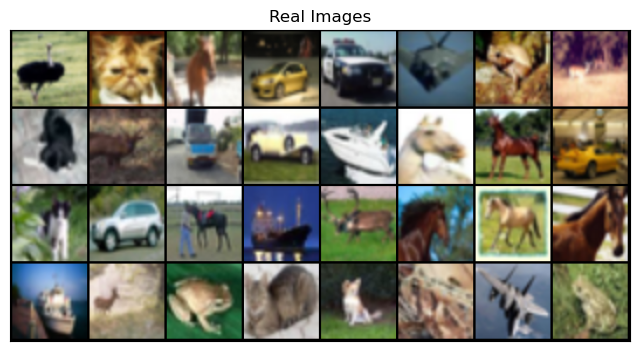

In [14]:
def imshow(imgs, title, figsize=(8,8), nrow=8):
    imgs = vutils.make_grid(imgs, nrow, normalize=True)
    imgs=imgs.numpy()
    imgs=np.transpose(imgs, (1,2,0))
    plt.figure(figsize=figsize)
    plt.imshow(imgs)
    plt.xticks([])
    plt.yticks([])
    plt.title(title)
    plt.show()
    
images, labels = next(iter(trainloader))
imshow(images[:32], 'Real Images')

Generator & Discriminator

In [15]:
class Generator(nn.Module):
    def __init__(self):
        super(Generator, self).__init__()
        self.net = nn.Sequential(
            nn.ConvTranspose2d(Z_DIM, GEN_FEATURES*16, 4, 1, 0, bias=False), # 1024 x 4 x 4
            self._block(GEN_FEATURES*16, GEN_FEATURES*8, 4, 2, 1),           # 512 x 8 x 8
            self._block(GEN_FEATURES*8, GEN_FEATURES*4, 4, 2, 1),            # 256 x 16 x 16
            self._block(GEN_FEATURES*4, GEN_FEATURES*2, 4, 2, 1),            # 128 x 32 x 32
            nn.ConvTranspose2d(GEN_FEATURES*2, IMAGE_CHANNELS, 4, 2, 1),     # 64 x 64 x 64  #size. (n_channels) x 64 x 64
            nn.Tanh() 
        
        )
        
    def _block(self, in_channels, out_channels, kernel, stride, padding):
        return nn.Sequential(nn.ConvTranspose2d(in_channels, out_channels, kernel, stride, padding, bias=False),
                             nn.BatchNorm2d(out_channels),
                             nn.ReLU()
                            )
    
    def forward(self, z):
        return self.net(z)


In [16]:
class Discriminator(nn.Module):
    def __init__(self):
        super(Discriminator, self).__init__()
        self.net = nn.Sequential(
            # input size: 3 x 64 x 64
            nn.Conv2d(IMAGE_CHANNELS, DISC_FEATURES, kernel_size=4, stride=2, padding=1, bias=False),
            nn.LeakyReLU(0.2),                          # 64 x 32 x 32
            self._block(DISC_FEATURES, DISC_FEATURES*2, 4, 2, 1),     # 128 x 16 x 16
            self._block(DISC_FEATURES*2, DISC_FEATURES*4, 4, 2, 1),   # 256 x 8 x 8
            self._block(DISC_FEATURES*4, DISC_FEATURES*8, 4, 2, 1),   # 512 x 4 x 4
            nn.Conv2d(DISC_FEATURES*8, 1, 4, 1, 0, bias=False),       # 1 x 1 x 1
            nn.Sigmoid()
        )
        
        
    def _block(self, in_channels, out_channels, kernel, stride, padding):
        return nn.Sequential(nn.Conv2d(in_channels, out_channels, kernel, stride, padding, bias=False),
                             nn.BatchNorm2d(out_channels),
                             nn.LeakyReLU(0.2),
                            )
    
    def forward(self, x):
        return self.net(x)

In [17]:
def weight_initialization(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
        nn.init.constant_(m.bias.data, 0)
            
            
DiscModel =Discriminator().to(device)
GenModel = Generator().to(device)

#initialize weights for both models
DiscModel.apply(weight_initialization)
GenModel.apply(weight_initialization)
criterion = nn.BCELoss()
fixed_noise = torch.randn(96, Z_DIM, 1, 1).to(device)

x_label = 1.
z_label = 0.

disc_optimizer = optim.Adam(DiscModel.parameters(), lr=LEARNING_RATE, betas=(BETA1, 0.999))
gen_optimizer = optim.Adam(GenModel.parameters(), lr=LEARNING_RATE, betas=(BETA1, 0.999))

In [21]:
import os

# Ensure the directories exist before saving files
model_dir = 'Models'
pickle_dir = 'pickle'

# Create the directories if they don't exist
if not os.path.exists(model_dir):
    os.makedirs(model_dir)
if not os.path.exists(pickle_dir):
    os.makedirs(pickle_dir)

# Save the trained model
print("Saving trained model...")
torch.save(GenModel, f'{model_dir}/dcgan.pth')

# Save the loss data to a pickle file
print("Saving losses to pickle file...")
losses = {'GenLoss': G_LOSS, 'DiscLoss': D_LOSS}
with open(f'{pickle_dir}/dcgan_loss.txt', 'wb') as f:
    pickle.dump(losses, f)

# Save the generated images for visualization
print("Saving generated images to pickle file...")
with open(f'{pickle_dir}/dcganImg.txt', 'wb') as f:
    pickle.dump(img_list, f)


Saving trained model...
Saving losses to pickle file...
Saving generated images to pickle file...


Training phase

Starting training...
Epoch 1/40 started.
Epoch 1, Iteration 0: Loss_D = 0.2102, Loss_G = 3.1930
Epoch 1, Iteration 100: Loss_D = 0.1586, Loss_G = 2.9941
Epoch 1, Iteration 200: Loss_D = 0.0085, Loss_G = 5.6195
Epoch 1, Iteration 300: Loss_D = 0.0060, Loss_G = 5.2841
Epoch 1, Iteration 400: Loss_D = 0.0103, Loss_G = 6.0754
Epoch 2/40 started.
Epoch 2, Iteration 0: Loss_D = 0.0071, Loss_G = 5.1360
Epoch 2, Iteration 100: Loss_D = 0.6258, Loss_G = 0.2401
Epoch 2, Iteration 200: Loss_D = 0.2106, Loss_G = 2.8187
Epoch 2, Iteration 300: Loss_D = 0.1998, Loss_G = 3.2792
Epoch 2, Iteration 400: Loss_D = 0.1869, Loss_G = 2.7881
Epoch 3/40 started.
Epoch 3, Iteration 0: Loss_D = 0.0701, Loss_G = 3.3416
Epoch 3, Iteration 100: Loss_D = 0.1861, Loss_G = 4.6053
Epoch 3, Iteration 200: Loss_D = 0.0277, Loss_G = 4.2867
Epoch 3, Iteration 300: Loss_D = 0.3840, Loss_G = 1.3836
Epoch 3, Iteration 400: Loss_D = 0.3375, Loss_G = 5.0896
Epoch 4/40 started.
Epoch 4, Iteration 0: Loss_D = 0.2118, Loss_G = 3.

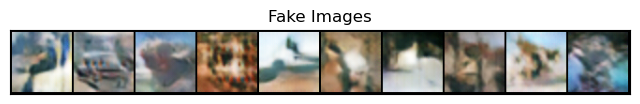

Epoch 11/40 started.
Epoch 11, Iteration 0: Loss_D = 0.0131, Loss_G = 5.0832
Epoch 11, Iteration 100: Loss_D = 0.0806, Loss_G = 2.7666
Epoch 11, Iteration 200: Loss_D = 0.0109, Loss_G = 5.5178
Epoch 11, Iteration 300: Loss_D = 0.1797, Loss_G = 2.8059
Epoch 11, Iteration 400: Loss_D = 0.2735, Loss_G = 2.9208
Epoch 12/40 started.
Epoch 12, Iteration 0: Loss_D = 0.3936, Loss_G = 3.7157
Epoch 12, Iteration 100: Loss_D = 0.4637, Loss_G = 3.8617
Epoch 12, Iteration 200: Loss_D = 0.3577, Loss_G = 2.7705
Epoch 12, Iteration 300: Loss_D = 0.3454, Loss_G = 1.9620
Epoch 12, Iteration 400: Loss_D = 0.2622, Loss_G = 2.2208
Epoch 13/40 started.
Epoch 13, Iteration 0: Loss_D = 0.8798, Loss_G = 1.2577
Epoch 13, Iteration 100: Loss_D = 0.0811, Loss_G = 3.6890
Epoch 13, Iteration 200: Loss_D = 0.0086, Loss_G = 5.8705
Epoch 13, Iteration 300: Loss_D = 0.1147, Loss_G = 3.4136
Epoch 13, Iteration 400: Loss_D = 0.1120, Loss_G = 4.7880
Epoch 14/40 started.
Epoch 14, Iteration 0: Loss_D = 0.2542, Loss_G = 1.9

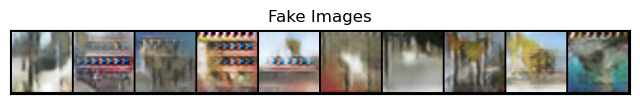

Epoch 21/40 started.
Epoch 21, Iteration 0: Loss_D = 0.0030, Loss_G = 6.1498
Epoch 21, Iteration 100: Loss_D = 0.0061, Loss_G = 5.8035
Epoch 21, Iteration 200: Loss_D = 0.0047, Loss_G = 6.0379
Epoch 21, Iteration 300: Loss_D = 0.0025, Loss_G = 6.5156
Epoch 21, Iteration 400: Loss_D = 0.0019, Loss_G = 6.5360
Epoch 22/40 started.
Epoch 22, Iteration 0: Loss_D = 0.0010, Loss_G = 7.4232
Epoch 22, Iteration 100: Loss_D = 0.0013, Loss_G = 7.8767
Epoch 22, Iteration 200: Loss_D = 0.0014, Loss_G = 6.7692
Epoch 22, Iteration 300: Loss_D = 0.0004, Loss_G = 7.8238
Epoch 22, Iteration 400: Loss_D = 0.0004, Loss_G = 7.8207
Epoch 23/40 started.
Epoch 23, Iteration 0: Loss_D = 0.0009, Loss_G = 6.9185
Epoch 23, Iteration 100: Loss_D = 0.0003, Loss_G = 8.7705
Epoch 23, Iteration 200: Loss_D = 0.0006, Loss_G = 7.0413
Epoch 23, Iteration 300: Loss_D = 0.0009, Loss_G = 6.9574
Epoch 23, Iteration 400: Loss_D = 0.0009, Loss_G = 6.9690
Epoch 24/40 started.
Epoch 24, Iteration 0: Loss_D = 0.0000, Loss_G = 10.

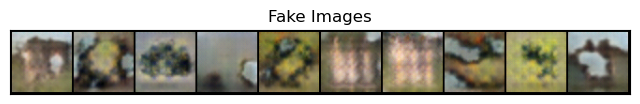

Epoch 31/40 started.
Epoch 31, Iteration 0: Loss_D = 0.0620, Loss_G = 4.7654
Epoch 31, Iteration 100: Loss_D = 0.0129, Loss_G = 5.2383
Epoch 31, Iteration 200: Loss_D = 0.0907, Loss_G = 5.7188
Epoch 31, Iteration 300: Loss_D = 0.0645, Loss_G = 4.3692
Epoch 31, Iteration 400: Loss_D = 0.0393, Loss_G = 5.2259
Epoch 32/40 started.
Epoch 32, Iteration 0: Loss_D = 0.0410, Loss_G = 5.0733
Epoch 32, Iteration 100: Loss_D = 0.0198, Loss_G = 5.8440
Epoch 32, Iteration 200: Loss_D = 0.0137, Loss_G = 5.3508
Epoch 32, Iteration 300: Loss_D = 0.1375, Loss_G = 6.1469
Epoch 32, Iteration 400: Loss_D = 0.0107, Loss_G = 6.0599
Epoch 33/40 started.
Epoch 33, Iteration 0: Loss_D = 0.0958, Loss_G = 5.4588
Epoch 33, Iteration 100: Loss_D = 0.0153, Loss_G = 6.6087
Epoch 33, Iteration 200: Loss_D = 0.1342, Loss_G = 7.0708
Epoch 33, Iteration 300: Loss_D = 0.0220, Loss_G = 4.7229
Epoch 33, Iteration 400: Loss_D = 0.0126, Loss_G = 5.4482
Epoch 34/40 started.
Epoch 34, Iteration 0: Loss_D = 0.0244, Loss_G = 4.9

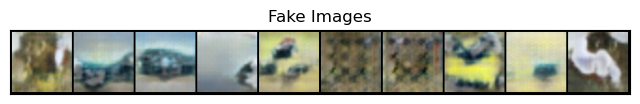

Saving final generated images...
Saving trained model...
Saving losses to pickle file...
Saving generated images to pickle file...
Training complete and results saved.


In [27]:
import torch
import torchvision.utils as vutils
import pickle

img_list = []
G_LOSS = []
D_LOSS = []
FID_score = []

print("Starting training...")

for epoch in range(1, EPOCHS + 1):
    print(f"Epoch {epoch}/{EPOCHS} started.")
    DiscModel.train()
    GenModel.train()

    for i, (real, _) in enumerate(trainloader):
        real = real.to(device)
        mb_size = real.size(0)

        #### (1) TRAIN DISCRIMINATOR TO MAXIMIZE log(D(x)) + log(1- D(G(z)))
        noise = torch.randn(mb_size, Z_DIM, 1, 1).to(device)
        # generate fake images
        fake = GenModel(noise)
        # train discriminator with real images
        disc_real = DiscModel(real).view(-1)
        label = torch.ones_like(disc_real)
        Dloss_real = criterion(disc_real, label)
        # train discriminator with fake images
        disc_fake = DiscModel(fake.detach()).view(-1)
        label = torch.zeros_like(disc_fake)
        Dloss_fake = criterion(disc_fake, label)
        lossDisc = (Dloss_real + Dloss_fake) / 2
        DiscModel.zero_grad()
        lossDisc.backward()
        disc_optimizer.step()

        #### (2) TRAIN GENERATOR TO MAXIMIZE log(D(G(z)))
        GenModel.zero_grad()
        label = torch.ones_like(disc_real)
        output = DiscModel(fake).view(-1)
        lossG = criterion(output, label)
        lossG.backward()
        gen_optimizer.step()

        # Save losses for plotting
        G_LOSS.append(lossG.item())
        D_LOSS.append(lossDisc.item())

        if lossG.item() == 0.0:
            print(f"Early stopping at epoch {epoch}, iteration {i}: Generator loss is zero.")
            break  # Stop training early if generator loss is zero

        # Print progress for every 100th iteration
        if i % 100 == 0:
            print(f"Epoch {epoch}, Iteration {i}: Loss_D = {lossDisc.item():.4f}, Loss_G = {lossG.item():.4f}")

    # After each epoch, save the generated images
    with torch.no_grad():
        GenModel.eval()
        fakes = GenModel(fixed_noise).detach().cpu()
        img_list.append(vutils.make_grid(fakes, padding=2, normalize=True, nrow=6))

    # Save real and fake images to disk
    vutils.save_image(real.cpu(), f'Images/dcganimages/real/image{epoch}.png', nrow=10, normalize=True)
    vutils.save_image(fakes.cpu(), f'Images/dcganimages/fake/image{epoch}.png', nrow=10, normalize=True)

    # Print status every 10 epochs
    if epoch % 10 == 0:
        print(f'[{epoch}/{EPOCHS}] Loss_D: {lossDisc.item():.4f}   Loss_G: {lossG.item():.4f}')
        imshow(fakes[:10].cpu(), 'Fake Images', figsize=(8,8), nrow=10)

# Save the final generated images
print("Saving final generated images...")
vutils.save_image(fakes[:10].cpu(), 'Images/dcganimage10.png', nrow=10)
vutils.save_image(fakes[:24].cpu(), 'Images/dcganimage.png')
vutils.save_image(fakes[:10].cpu(), 'Images/dcganimage10norm.png', nrow=10, normalize=True)
vutils.save_image(fakes[:24].cpu(), 'Images/dcganimagenorm.png', normalize=True)

# Save the trained model
print("Saving trained model...")
torch.save(GenModel, 'Models/dcgan.pth')

# Save the loss data to a pickle file
print("Saving losses to pickle file...")
losses = {'GenLoss': G_LOSS, 'DiscLoss': D_LOSS}
with open('pickle/dcgan_loss.txt', 'wb') as f:
    pickle.dump(losses, f)

# Save the generated images for visualization
print("Saving generated images to pickle file...")
with open('pickle/dcganImg.txt', 'wb') as f:
    pickle.dump(img_list, f)

print("Training complete and results saved.")


Plot of the Loss

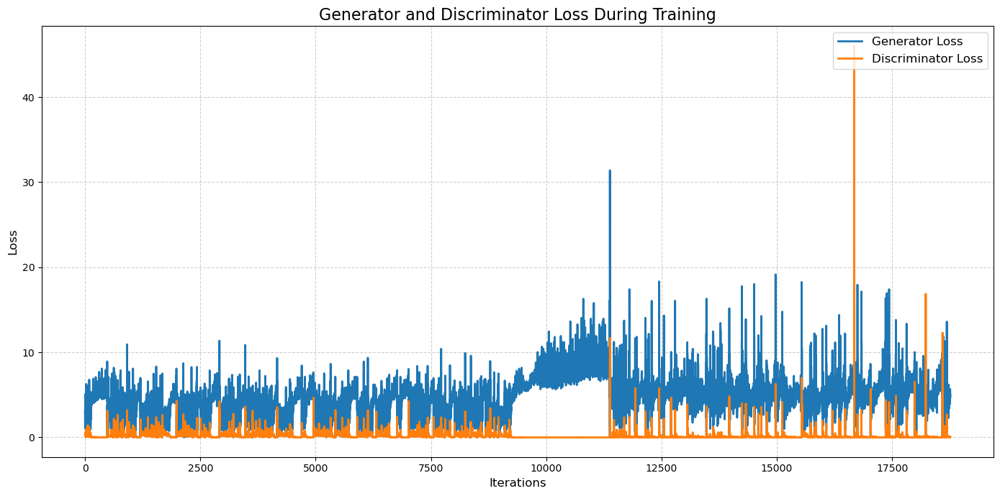

In [28]:
import matplotlib.pyplot as plt
import pickle

# Load the loss data
with open('pickle/dcgan_loss.txt', 'rb') as f:
    loss = pickle.load(f)

# Set up the figure with a custom style
plt.figure(figsize=(14,7))
plt.title("Generator and Discriminator Loss During Training", fontsize=16)
plt.plot(loss['GenLoss'], label="Generator Loss", color='tab:blue', linewidth=2)
plt.plot(loss['DiscLoss'], label="Discriminator Loss", color='tab:orange', linewidth=2)

# Customize axes
plt.xlabel("Iterations", fontsize=12)
plt.ylabel("Loss", fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# Add grid for better readability
plt.grid(True, linestyle='--', alpha=0.6)

# Add legend with a customized location
plt.legend(loc="upper right", fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()


Calculate FID scores

In [29]:
from FID import fidScore
dcgan_FID = []
for i in range(1,40):
    i = i+1
    fids = fidScore('Images/dcganimages/real', 'Images/dcganimages/fake',i,128)
    print(f'Epoch:{i} and FID Score: {fids}', end = '\r', flush=True)
    dcgan_FID.append(fids)

with open('pickle/dcganfid.txt', 'wb') as f:
    pickle.dump(dcgan_FID,f)

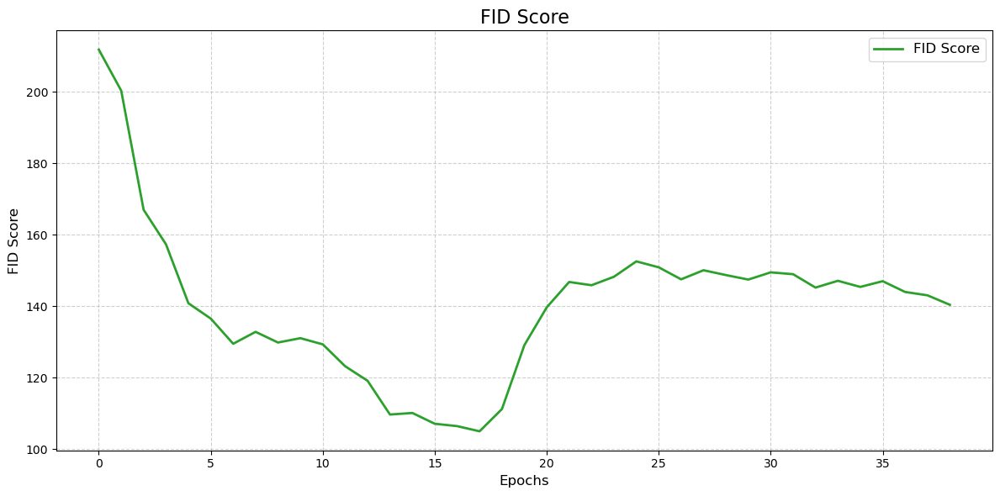

In [30]:
import matplotlib.pyplot as plt

# Set up the figure with a custom style
plt.figure(figsize=(12,6))
plt.title("FID Score", fontsize=16)

# Plot the FID score with customized style
plt.plot(dcgan_FID, label="FID Score", color='tab:green', linewidth=2)

# Customize axes
plt.xlabel("Epochs", fontsize=12)
plt.ylabel("FID Score", fontsize=12)
plt.xticks(fontsize=10)
plt.yticks(fontsize=10)

# Add grid for better readability
plt.grid(True, linestyle='--', alpha=0.6)

# Add legend with a customized location
plt.legend(loc="upper right", fontsize=12)

# Show the plot
plt.tight_layout()
plt.show()


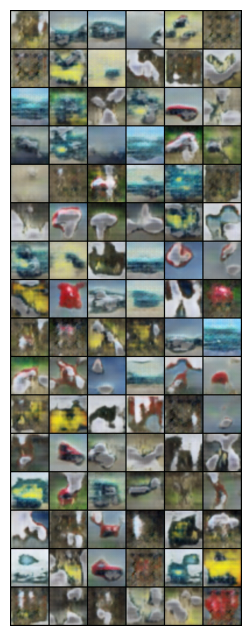

In [31]:
#%%capture
plt.rcParams['animation.embed_limit'] = 50 
with open('pickle/dcganImg.txt', 'rb') as f:
    image_list = pickle.load(f)

fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i.cpu(),(1,2,0)), animated=True)] for i in image_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())